# **Computer Vision - Assignment 3 - IMAGE REGISTRATION USING HOMOGRAPHIES**
#### Value: 10 (+4) points | Due date: December 22 23:59 | Submission site: https://pradogrado2223.ugr.es/

### Student's Full Name: <mark>Brian Sena Simons</mark>


In this assignment you will learn:

a) How to detect relevant regions using the Harris's algorithm.

b) How to detect matches between images using SIFT descriptors.

c) How to compose a mosaic from a bunch of images. 

## Normas de entrega

Para este trabajo, al igual que para los demás, se deben presentar  las valoraciones y decisiones adoptadas en cada uno de los apartados. También deberá incluirse una valoración sobre la calidad de los resultados obtenidos. Se recuerda que código sin informe explicativo no puntúa.

Para poder evaluar el BONUS se debe obtener al menos el 70% de los puntos de la parte obligatoria

Normas de entrega (EL INCUMPLIMIENTO DE ESTAS NORMAS SIGNIFICA PÉRDIDA DIRECTA DE 1 PUNTO CADA VEZ QUE SE DETECTE UN INCUMPLIMIENTO):

1. El diseño de celdas del documento debe ser respetado.
2. Solo se entregará el código fuente (fichero .ipynb, y ficheros auxiliares externos: P0.py y P1.py) y no se enviarán las imágenes empleadas.
3. Los path que se usen en la lectura de imágenes o cualquier otro fichero de entrada debe ser siempre “/content/drive/My Drive/images/nombre_fichero”
4. El código deberá  presentarse junto con los resultados obtenidos en cada apartado y los  correspondientes comentarios, explicaciones y valoraciones.  Recuerde que la entrega de código sin informe explicativo o valoraciones no puntúa.

The next cell is intended to install an upgrade of the OpenCV package that includes the SIFT algorithm. After the installation, the  python-kernel (restart runtime) has to be restarted to import the new release.

In [ ]:
import sys, cv2
(major, minor,_)=cv2.__version__.split(".")
if int(minor) < 5:
  if 'google.colab' in sys.modules:
    import subprocess
    subprocess.call("pip install -U opencv-python".split())

print(cv2.__version__)

4.6.0


This cell sets the environment and imports your packages

Adjunto a esta práctica el código P1.py, en ese archivo apenas hay dos líneas que se cambiaron: 
```
# change directory
! cd '/content/drive/MyDrive'  -> %cd '/content/drive/MyDrive' 
#  the current directory
! pwd                          -> %pwd 
```
No era posible importar la P1 si mantenía el uso de `!`; No recuerdo ahora mismo la razón por la cuál se realizaron tales cambios pero el ajuste final fue necesario para poder importar la práctica y realizar el cálculo de las derivadas.  

In [ ]:
# Let's start importing all background modules
# We start by getting access to the drive
from google.colab import drive
drive.mount('/content/drive', force_remount=True)
import sys,os
# change directory
%cd '/content/drive/My Drive'
# Let's import the python module exercises.py  to have access to its functions and Classes
path_to_module='/content/drive/My Drive/CV/'
sys.path.append(os.path.abspath(path_to_module))
import P0,P1
get_image = lambda route: os.path.join('/content/drive/My Drive/images/', route)
import numpy as np
from matplotlib import pyplot as plt

Mounted at /content/drive
/content/drive/My Drive


# **Exercise 1:** Harris detector and non-maxima suppresion (3 points)

Write Python code to implement the detection of the strongest 100-150 Harris points in an image, and show your results using the function cv2.drawKeyPoints(). You can apply OpenCV's functions getDerivKernels() and sepFilter2D(). However, those who use their own code from P1 (for computing the derivatives) could have a bonus of +1 point. 

Hint (use different cells for the items):\
a) Fix the derivative and integration scales. Try first sigma values in the range 1-3.\
b) Compute the derivative images. \
c) Compute the three terms of the second moment matrix (SMM) at each pixel. To do it, apply the convolution with a Gaussian mask of size the integration area. \
d) Compute the Harris value at each pixel (discard the points close to the edges).\
e) Apply Non-Maxima Suppression by using the function corner_peaks() from the module skimage.features. The student must set the minimum distace between maxima. The output will be a list of (x,y) coordinates.  Extract the values in these coordinates and create a list of vectors (x,y,value).\
f) Compute the main orientation for each point. This is done by smoothing both derivative images with a sufficiently large sigma (sigma=3) and computing the orientation of the gradient at those points.\
d) Create a list of KeyPoints using the selected points. A KeyPoint is a vector including (x,y,scale,orientation).\
e) Draw the keypoints on the image using the function cv2.drawKeypoints().


## Introducción teórica: 

En los campos de la visión por computador y el análisis de imágenes, el detector de región afín de Harris pertenece a la categoría de detección de características.
La detección de características es un paso de procesamiento previo de varios algoritmos que se basan en la identificación de puntos de interés para hacer correspondencias entre imágenes, reconocer texturas, categorizar objetos o crear panoramos. 

Harris es un detector de punto de interés invariantes afín. Nos quedaremos en la implementación del proceso de extracción de esquinas y puntos: 
1. Pasamos la imágen a la escala de grises.
2. Tomamos las derivadas espaciales 
3. Estructuramos los tensores y calculamos las respuestas.
4. Suprimimos los valores no-máximos. 

Se basa en gran medida en la obtención de la medida de esquinas: 
El algoritmo se basa en un principio central: *en una esquina, la intensidad de la imagen cambiará en gran medida en múltiples direcciones. Alternativamente, esto se puede formular examinando los cambios de intensidad debidos a los cambios en una ventana local. Siguiendo esta intuición y mediante una inteligente descomposición, el detector de Harris utiliza la matriz del segundo momento o, también se denomina, la matriz de autocorrelación: 
$$ 
A(x) = \sum_{p,q}w(p,q)\left[ \matrix{dI_x^2(p,q) & dI_xdI_y(p,q) \\ dI_xdI_y(p,q) & dI_y^2(p,q)} \right] 
$$ 
Dónde $dI_x$ representaría la derivada de la imagen en el eje x. Análogamente para los demás. 
La matriz A describe la forma de la medida de autocorrelación debida a cambios en la ubicación de la ventana. Sabemos que los valores propios nos permiten describir de forma cuantitativa la variación de la autocorrelación.  Por lo tanto podemos inferir que la matriz centrada en los puntos de las esquinas tendrá dos valores propios grandes. La respuesta viene dada por: 
$$
R = det(A) - \sigma trace^2(A) = \lambda_1 \lambda_2 - \sigma(\lambda_1+\lambda_2)^2
$$ 
Como hemos dicho, las esquinas tienen valores grandes, por lo que buscaremos máximos sobre las imágenes. 

[Más información](https://en.wikipedia.org/wiki/Harris_affine_region_detector#Harris%E2%80%93Laplace_detector_(initial_region_points))

## Implementación:

El primer paso para implementar el detector es hacer un buen cálculo de las derivadas de la imagen. Para ello, llamaremos a las funciones definidas en las prácticas anteriores que nos proveen con lo necesario para obtener de forma inmediata las derivadas necesarias: 

In [ ]:
# Compute image derivatives
def derivatives(im,sigmaD):
  dx = P1.my2DConv(im,sigmaD,orders=[1,0])
  dy = P1.my2DConv(im,sigmaD,orders=[0,1])
  return dx,dy


`P1.my2DConv` Nos devuelve la derivada de la matriz especificada por el parámetro `orders` (Que define el orden de la matriz y la dirección, tal que `orders=[1,0]`nos devuelve la primera derivada en el eje x). El tamaño de la ventana viene dado por el parámetro `sigma`. De esta forma es como obtenemos las dos derivadas que nos hace falta. 

El siguiente paso es computar el mapa de respuestas de Harris. Para ello, tenemos que construir la matriz de segundo momento como en la fórmula especificada anteriormente. Para ello haremos uso de las directivas de numpy para el cálculo o múltiplicaciones elemento a elemento. Además, algo que no se mencionó en la introducción teórica fue la componente `w(p,q)`.
Esa componente es un suavizado gaussiano aplicado a las respuestas obtenidas que actúa para promediar en una región local al mismo tiempo que pondera los valores cerca del centro más fuertemente. 
$$
w(x,y) = g(x,y,\sigma) = \frac{1}{2\pi \sigma^2}e^{-\frac{x^2+y^2}{2\sigma^2}}
$$ 
Para suavizar multiplicaré cada componente de la matriz por la guassiana generada con `sigmaI` haciendo uso de la misma función anterior. Una vez tengamos la matriz de segundo momento las respuestas se podrían calcular de la siguiente forma: 
$$ 
f_h = \frac{\lambda_1 \lambda_2}{\lambda_1 + \lambda_2} = \frac{Det(H)}{Trace(H)} = \frac{(\sum_w w(p,q)\partial I_x^2 \cdot (\sum_w w(xp,q)\partial I_ y^2) - (\sum_w w(p,q)\partial I_xI_y \cdot ((\sum_w w(xp,q)\partial I_xI_ y) }{ (\sum_w w(p,q)\partial I_x^2 + ((\sum_w w(xp,q)\partial I_ y^2) }
$$ 

In [ ]:
# Compute Harris-criterium Map
def HarrisMap(dx,dy,sigmaI):
  # Compute the three terms of the SMM at each pixel and he map values
  sq_dx = np.multiply(dx,dx)
  sq_dx = P1.my2DConv(sq_dx,sigmaI,orders=[0,0])
  sq_dy = np.multiply(dy,dy)
  sq_dy = P1.my2DConv(sq_dy,sigmaI,orders=[0,0])
  dxdy = np.multiply(dx,dy)
  dxdy = P1.my2DConv(dxdy,sigmaI,orders=[0,0])
  HMap =  (np.multiply(sq_dx,sq_dy) - np.multiply(dxdy,dxdy)) / (sq_dx + sq_dy) 
  return HMap

Los resultados devueltos por la función `HarrisMap` será un canvas negro con pequeñas activaciones de mayor o menor intensidad distribuidas en su totalidad. Esas regiones marcadas son los puntos de interés que buscamos. Sin embargo, cerca de un máximo, hay múltiples activaciones por lo que habrá que filtrar esas activaciones de alguna manera. (Imagínese una línea, o umbral, que determina un punto de interés cuando la función sobrepasa el valor X, Si tenemos un máximo en 2*X, también lo tendremos en X + 1, X + 2 y cuando empezemos a bajar otra vez igual...) 

[WARNING]: Image is in GrayScale
[WARNING]: flag_Global ignored for monoband


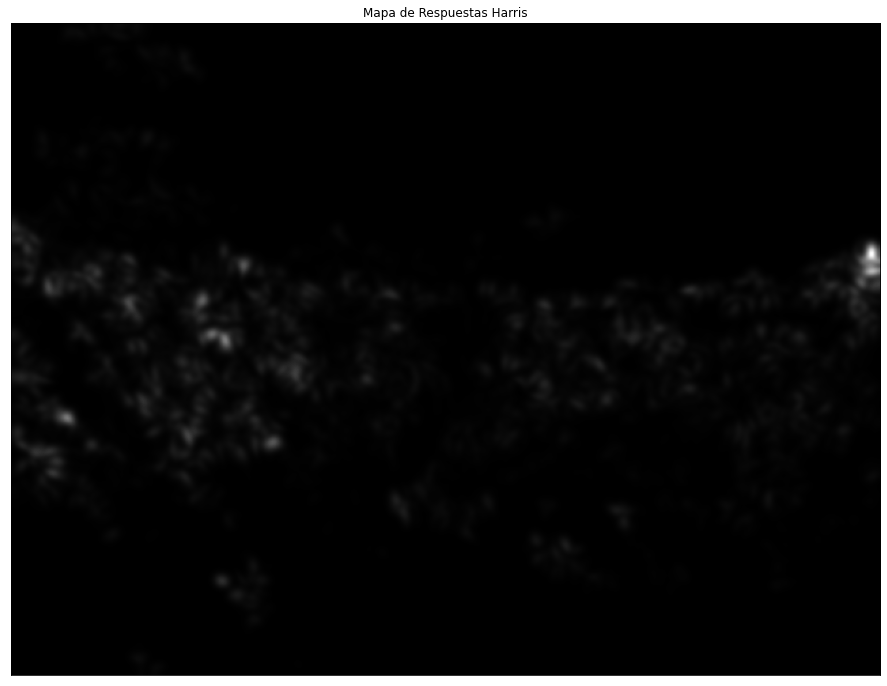

In [ ]:
img=P0.readIm(get_image('yosemite7.jpg'),0).astype("float32")
dx,dy = derivatives(img,3) 
Hmap = HarrisMap(dx,dy,3) 
P0.displayIm(Hmap, 'Mapa de Respuestas Harris',3)

Como se puede ver de cierto modo, tenemos como una nube de puntos blancos por toda la región central de izquierda a derecha de la imagen. Veremos que tras la supressión, muchos de los puntos desapareceran pero la distribución se mantendrá. 

The following cell implements the Non-Maxima-Suppression stage. This function calls the corner_peaks() function from the skimage.feature package (see below). This function returns the local maxima sorted by value.

Para la supresión de los máximos, haremos uso de una función denominada `corner_peaks`. Esta función, dada una imagen de entrada nos permite filtrar multiples activaciones dado una distancia mínima entre puntos, `min_distance`. un umbral absoluto, `threshold_abs`, o un umbral relativo, `threshold_rel`. 

Al final he optado por utilizar un umbral relativo al máximo global de la imagen dado que es más fácil de utilizar para múltiples imágenes que pueden provocar diferentes valores de activaciones. De esta forma podemos hablar de porcentajes en vez de número arbitrarios. 

Una vez obtenido las coordenadas de los puntos máximos, deberíamos ordenar por valor. La función anterior ya nos lo devuelve ordenados asi que solo tenemos que mirar el valor en `harrisMap`. 

In [ ]:
from skimage.feature import corner_peaks
def NonMaximaSuppression(harrisMap, min_distance, threshold):
  points = corner_peaks(harrisMap, min_distance,threshold_rel=threshold,exclude_border=True)
  # check the order
  values = [harrisMap[p[0],p[1]] for p in points]
  coord = points
  return coord, values

In [ ]:
coord, values = NonMaximaSuppression(Hmap,1,0.1) 
print(len(coord))

95


Orientation is computed as the angle of the gradient after smoothing the derivative images with a Gaussian (with sigma=3).

A KeyPoint is an OpenCV's structure, associated to each detected region,  necessary to call OpenCV feature extraction algorithms. You have to create one KeyPoint structure per detected region with information about (location, scale,orientation). (See the OpenCV documentation for more information)

El mapa de respuestas al ser calculados a partir de los valores propios de la matriz A, sabemos que estamos tratando con una respuesta invariante a la rotación. Si rotamos una cuadrado de la imagen, la respuesta que genera, es decir, sus valores propios seguirán siendo los mismos. 

Es por ello por lo que podemos calcular los descriptores de la imagen teniendo en cuenta la orientación del gradiente y permitiendo arreglar problemas de rotación. 

Para calcular la orientación simplemente tenemos que aplicar la siguiente fórmula: 
$$ 
\theta = \frac{\tan^{-1} \left(\frac{smooth(dy)}{smooth(dx)}\right)\cdot180}{\pi}
$$ 

In [ ]:
# compute the orientation map
def orientation(dx,dy):
  # Let's compute  orientation in degrees
  sdy = P1.my2DConv(dy,sigma=3,orders=[0,0])
  sdx = P1.my2DConv(dx,sigma=3,orders=[0,0])
  theta = (np.arctan2(dy,dx) * 180)/np.pi
  return theta

In [ ]:
theta = orientation(dx,dy) 

Una vez calculado las orientaciones de los puntos, podemos instanciar cada punto por medio de la función `cv2.KeyPoint` con sus valores respectivos y guardarlos todo en un vector para luego poder pintar la imagen con toda la información calculada. 

In [ ]:
# Create the KeyPoint list from the information about locations, orientations and scale 
# keyPoint=KeyPoint(x_float, y_float, scale_float,orientation_float), in Harris scale=1
def keyPoints(coord,theta,size):
  points = [cv2.KeyPoint(float(p[1]),float(p[0]),size,float(theta[p[0]][p[1]])) for p in coord]
  return (points)
  

In [ ]:
points = keyPoints(coord,theta,1)

Para pintar la imagen solamente tendremos que llamar a `cv2.drawKeypoints` pasandole la imagen original sobre la cual va a pintar y los puntos generados. 

The following cell computes the Harris KeyPoints detection (calling to the previously implemented functions, like derivatives(), HarrisMap(), NonMaximaSuppression(), orientation() and keyPoints()), and displays them on the image. Use the function cv2.drawKeypoints() with flags, cv2.DRAW_MATCHES_FLAGS_DRAW_OVER_OUTIMG+cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS.

Una buena regla de dedo para elegir el umbral de puntos a eliminar es utilizar el rango `0.04-0.06`. Luego los valores que convienen utilizar para el sigma suele ser `sigmaD=1` y `sigmaI=2.5` 

La distancia mínima entre puntos hemos establecido que sea 1 píxel. 

Valores especificados en el paper: [análisis e implementación de Harris Corner Detector](http://www.ipol.im/pub/art/2018/229/article_lr.pdf) (Y sus variaciones y/o otras formas de calcular R y demás). 

[WARNING]: Image is in Color
[WARNING]: Normalizing globally


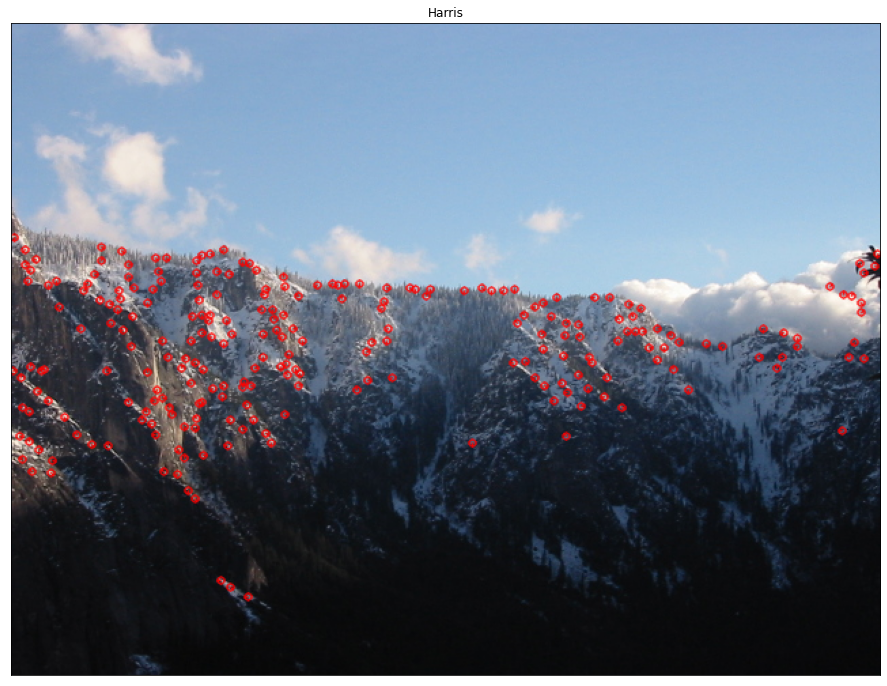

In [ ]:
# Let's compute the KeyPoints-Harris and display them
img = P0.readIm(get_image('yosemite7.jpg'),1)
img_bw = P0.readIm(get_image('yosemite7.jpg'),0).astype("float32") 

# parameters
sigmaD=1
sigmaI=2.5
min_distance=1
Threshold_MINVALUE=0.06
#
dx,dy = derivatives(img_bw,sigmaD) 
Hmap = HarrisMap(dx,dy,sigmaI) 
coord, values = NonMaximaSuppression(Hmap,min_distance,Threshold_MINVALUE) 
theta = orientation(dx,dy) 
keypoints= keyPoints(coord,theta,5)
#
if(len(keypoints)>0):
  cv2.drawKeypoints(img,keypoints, img, (255,0,0), cv2.DRAW_MATCHES_FLAGS_DRAW_OVER_OUTIMG+cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
  P0.displayIm(img,'Harris',factor=3) 

Vemos que al utilizar los valores recomendados, hemos obtenido una imagen con puntos característicos distribuidos por toda la imagen y además nos hemos quedado con suficientes puntos por si fueramos a hacer algún tipo de panorama (image stiching). 

In [ ]:
len(coord)

243

### Experimentación de valores y propiedades. 

Según hemos visto, deberíamos obtener el mismo resultado para los mismos parámetros si apenas rotamos la imagen ya que debería ser invariante a la rotación asi que podemos verificar empíricamente si se cumple a continuación: 

[WARNING]: Image is in Color
[WARNING]: Normalizing globally


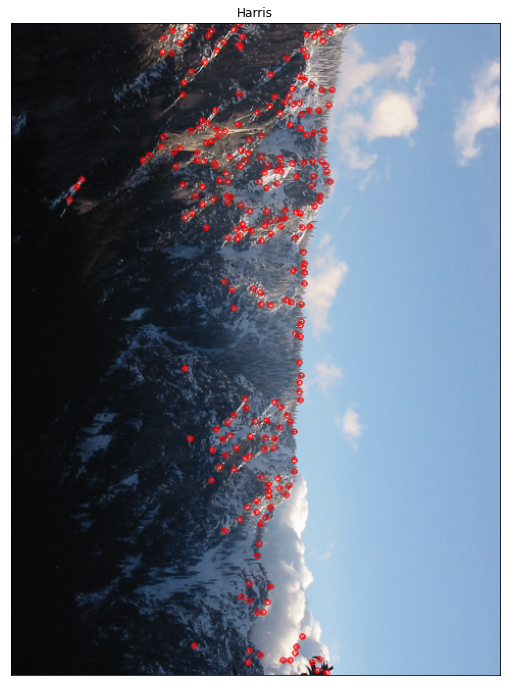

In [ ]:
# Let's compute the KeyPoints-Harris and display them
img = P0.readIm(get_image('yosemite7.jpg'),1)
img = cv2.rotate(img,cv2.ROTATE_90_CLOCKWISE) 
img_bw = P0.readIm(get_image('yosemite7.jpg'),0).astype("float32") 
img_bw = cv2.rotate(img_bw,cv2.ROTATE_90_CLOCKWISE) 

dx,dy = derivatives(img_bw,sigmaD) 
Hmap = HarrisMap(dx,dy,sigmaI) 
coord_r, values_r = NonMaximaSuppression(Hmap,min_distance,Threshold_MINVALUE) 
theta = orientation(dx,dy) 
keypoints_r= keyPoints(coord_r,theta,5)
#
if(len(keypoints)>0):
  cv2.drawKeypoints(img,keypoints_r, img, (255,0,0), cv2.DRAW_MATCHES_FLAGS_DRAW_OVER_OUTIMG+cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
  P0.displayIm(img,'Harris',factor=3) 

In [ ]:
print(coord.all() == coord_r.all()) 

True


Vemos que tenemos exactamente los mismos puntos e imagen. 
Pero sabemos que no es invariante al escalado no-uniforme en el espacio de escala, como se puede ver en la siguiente imagen: 


(480, 640, 3)
[WARNING]: Image is in Color
[WARNING]: Normalizing globally


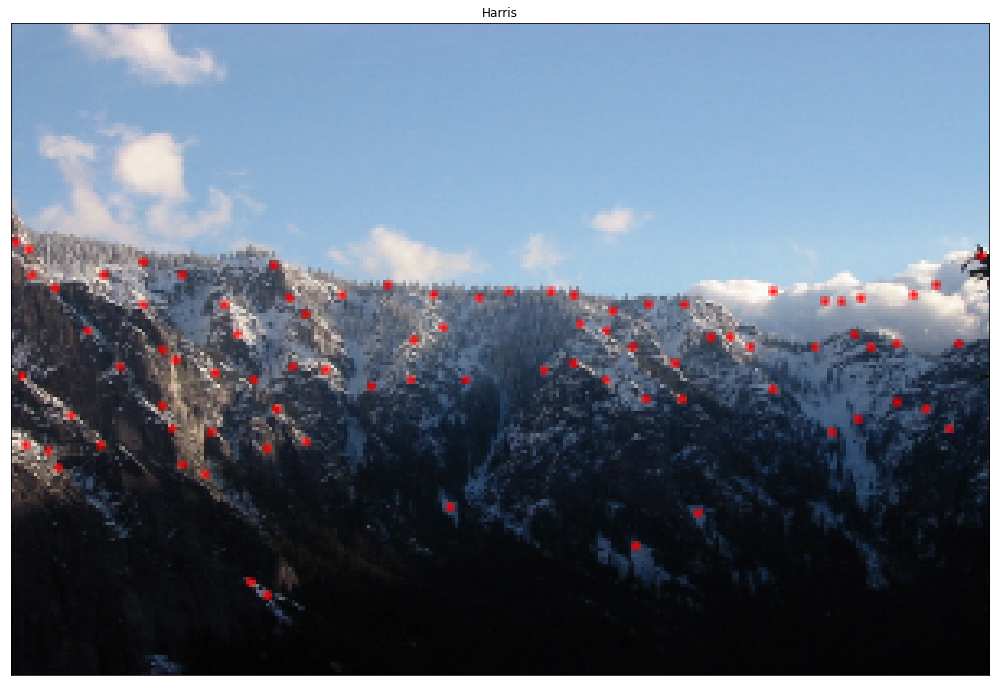

In [ ]:
# Let's compute the KeyPoints-Harris and display them
img = P0.readIm(get_image('yosemite7.jpg'),1)
print(img.shape)
width = 300
height = 200
img = cv2.resize(img, (width,height))
img_bw = P0.readIm(get_image('yosemite7.jpg'),0).astype("float32") 
img_bw = cv2.resize(img_bw,(width,height))

dx,dy = derivatives(img_bw,sigmaD) 
Hmap = HarrisMap(dx,dy,sigmaI) 
coord_r, values_r = NonMaximaSuppression(Hmap,min_distance,Threshold_MINVALUE) 
theta = orientation(dx,dy) 
keypoints_r= keyPoints(coord_r,theta,1)
#
if(len(keypoints)>0):
  cv2.drawKeypoints(img,keypoints_r, img, (255,0,0), cv2.DRAW_MATCHES_FLAGS_DRAW_OVER_OUTIMG+cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
  P0.displayIm(img,'Harris',factor=3) 

In [ ]:
print(len(coord_r), len(coord))

85 243


Vemos que tenemos muchisimos menos puntos que el caso anterior y sin haber cambiado ningún parámetro del algoritmo más que escalar la imagen de entrada de forma no uniforme. 

Veremos que pasa si mantenemos la entrada pero usamos otros valores: 

[WARNING]: Image is in Color
[WARNING]: Normalizing globally


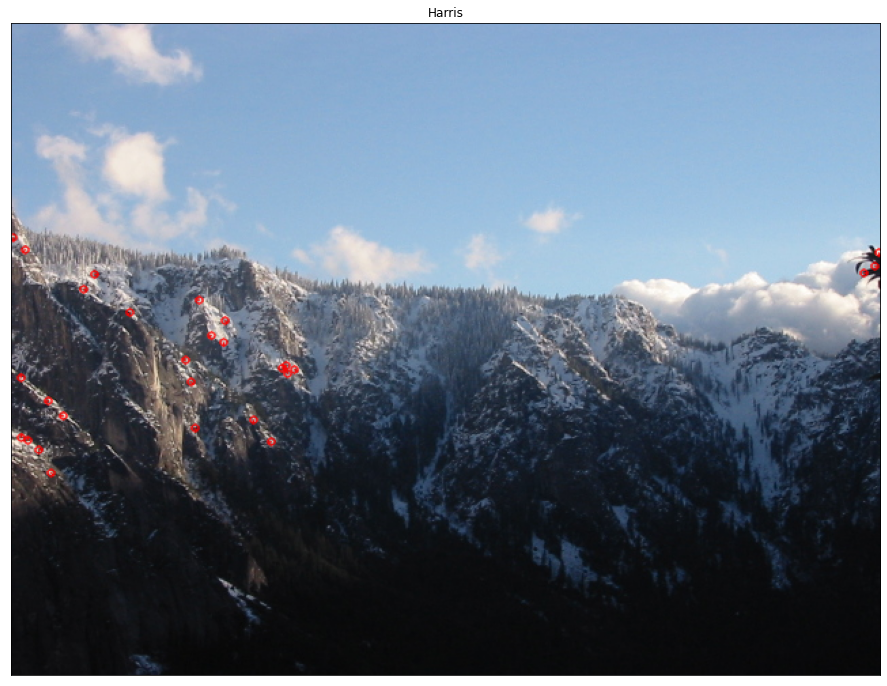

In [ ]:
img = P0.readIm(get_image('yosemite7.jpg'),1)
img_bw = P0.readIm(get_image('yosemite7.jpg'),0).astype("float32") 
# parameters
sigmaD=1
sigmaI=3
min_distance=1
Threshold_MINVALUE=0.2
#
dx,dy = derivatives(img_bw,sigmaD) 
Hmap = HarrisMap(dx,dy,sigmaI) 
coord, values = NonMaximaSuppression(Hmap,min_distance,Threshold_MINVALUE) 
theta = orientation(dx,dy) 
keypoints= keyPoints(coord,theta,5)
#
if(len(keypoints)>0):
  cv2.drawKeypoints(img,keypoints, img, (255,0,0), cv2.DRAW_MATCHES_FLAGS_DRAW_OVER_OUTIMG+cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
  P0.displayIm(img,'Harris',factor=3) 

Vemos que utilizar un umbral, `threshold_rel`, de eliminado alto implicar quedarnos con muy pocos puntos. Por lo que hay que tener lo díficil que sería utilizar `threshold_abs` para diferentes imágenes. 

[WARNING]: Image is in Color
[WARNING]: Normalizing globally


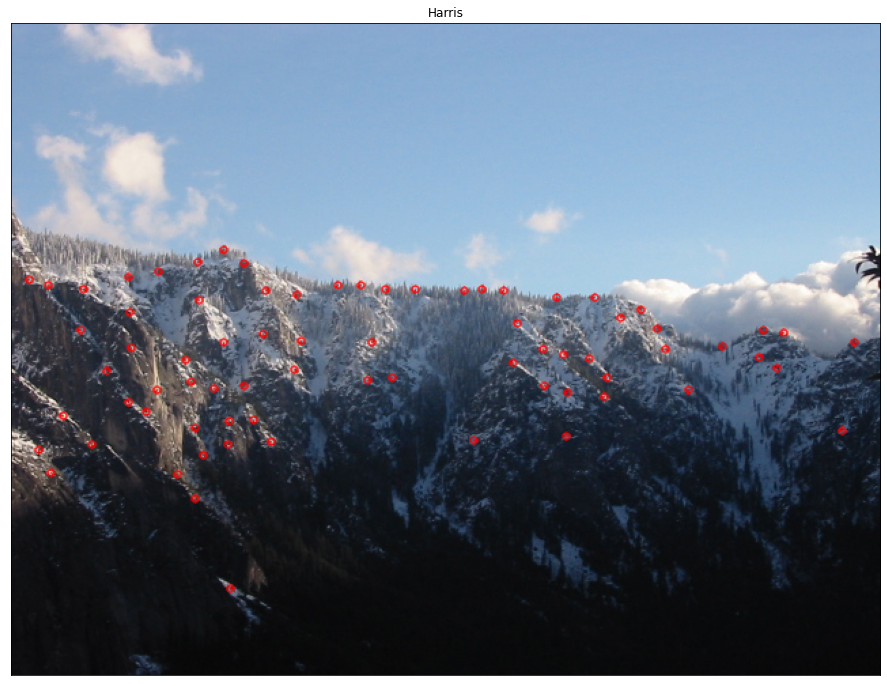

In [ ]:
img = P0.readIm(get_image('yosemite7.jpg'),1)
img_bw = P0.readIm(get_image('yosemite7.jpg'),0).astype("float32") 
# parameters
sigmaD=1
sigmaI=3
min_distance=10
Threshold_MINVALUE=0.06
#
dx,dy = derivatives(img_bw,sigmaD) 
Hmap = HarrisMap(dx,dy,sigmaI) 
coord, values = NonMaximaSuppression(Hmap,min_distance,Threshold_MINVALUE) 
theta = orientation(dx,dy) 
keypoints= keyPoints(coord,theta,5)
#
if(len(keypoints)>0):
  cv2.drawKeypoints(img,keypoints, img, (255,0,0), cv2.DRAW_MATCHES_FLAGS_DRAW_OVER_OUTIMG+cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
  P0.displayIm(img,'Harris',factor=3) 

En caso de que tuvieramos muchos puntos y muy centrados/localizados en una sola parte de la imagen podemos restringir nuestro modelo para que tenga una separación mínima entre los puntos y así distribuir y disminuir el número de puntos. 

[WARNING]: Image is in Color
[WARNING]: Normalizing globally


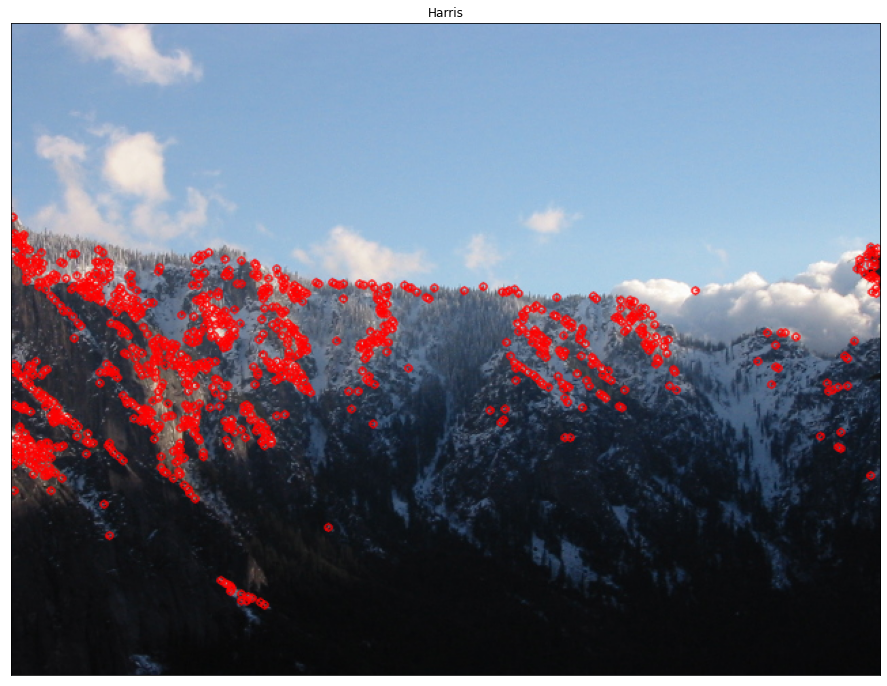

In [ ]:
img = P0.readIm(get_image('yosemite7.jpg'),1)
img_bw = P0.readIm(get_image('yosemite7.jpg'),0).astype("float32") 
# parameters
sigmaD=1
sigmaI=0.3
min_distance=1
Threshold_MINVALUE=0.06
#
dx,dy = derivatives(img_bw,sigmaD) 
Hmap = HarrisMap(dx,dy,sigmaI) 
coord, values = NonMaximaSuppression(Hmap,min_distance,Threshold_MINVALUE) 
theta = orientation(dx,dy) 
keypoints= keyPoints(coord,theta,5)
#
if(len(keypoints)>0):
  cv2.drawKeypoints(img,keypoints, img, (255,0,0), cv2.DRAW_MATCHES_FLAGS_DRAW_OVER_OUTIMG+cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
  P0.displayIm(img,'Harris',factor=3) 

Y los valores de sigma influyen también en la calidad y valores de los máximos que obtenemos. 

# **Exercise 2:** Matching keypoints between images using SIFT descriptors (2 points)

Write Python code to compute the matching between points from two images. To do so apply the SIFT algorithm to extract points and descriptors in both images.  Use the Force-Brute cross-check criteria and the KNN one to compute matches, and draw the matches between images using the function cv2.drawMatches(). 

## Introducción Teórica

Como sabemos,Harris Map no es invariante a la escala. Es decir, no nos serviría para generalizar nuestros modelos para el reconocimiento de objetos, detección de movimiento y entre otras. Fue por ello que David Lowe se dedicó a solventar este problema. 

La idea es similar al detector anterior. La primera etapa es aplicar la diferencia gaussiana con distintos tamaños de región t y buscar máximos locales, como antes, pero a lo largo tanto del espacio - determinado por las coordenadas x e y en la imagen - como de la escala - determinado por t.

Para una escala t dada la diferencia gaussiana da una fuerte respuesta para esquinas de tamaño tal que encaja con dicha escala. Por tanto en esta etapa se compara cada punto de la escala-espacio con los valores de sus vecinos en la misma escala y en las escalas anteriores y posteriores (Por ejemplos los 9 vecinos más cercanos). 

La localización de cada punto de interés encontrado se refina a precisión sub-pixel usando la expansión de serie de Taylos del escala-espacio. Y además, se aplica también algún algoritmo de supresión de no-máximos. La diferencia gaussiana da una fuerte respuesta en los bordes y es por ello que en SIFT usamos _la hessiana_ para calcular las curvaturas principales.

A continuación calculamos los descriptores de cada punto de la siguiente forma: 
Para cada punto se toma un vecindario de 16x16 puntos. Este, a su vez, se divide en sub-bloques de tamaño 4x4 para cada uno se crea un histograma de orientaciones. La concatenación en un vector de valores de las cajas de cada histograma para los 16 sub-bloques del punto de interés constituye su descriptor. 

A continuación se puede aplicar algún algoritmo de distancia entre los descriptores para emparejar los puntos. 

## Implementación: 

Para calcular los puntos podemos hacer uso de las funciones de openCv. En concreto utilizaremos `cv2.SIFT_create(nfeatures=nfeatures)`. A la cual simplemente tenemos que especificar el número de características a extraer. 

In [ ]:
# this function computes KeyPoints and descriptors in an image using SIFT
def siftPoints(im,nfeatures=5000):
  sift=cv2.SIFT_create(nfeatures=nfeatures)
  kp, ds = sift.detectAndCompute(im,None)  
  return kp,ds

Esto nos da directamente los puntos y descriptores adecuados. 

In OpenCV the output of a matching process is a vector of matches. Each match provides information about the indexes of the matched KeyPoints and the distance between them.

Una vez tengamos los descriptores y los puntos de interés respectivos podemos empezar a emparejar. El primer paso será el emparejamiento por fuerza bruta y a continuación haremos uso de la distancia de Lowe. Un KNN dónde cogeremos K=2 y calcularemos un ratio de distancia entre los dos puntos de tal forma que apenas cogeremos el mejor si su distancia es menor que una proporción de la segunda distancia. (no-ambiguos).

In [ ]:
# This function display the KeyPoints of an image
def showKP(img,kp,title):
  im = img.copy() 
  cv2.drawKeypoints(im,kp,im,-1, cv2.DRAW_MATCHES_FLAGS_DRAW_OVER_OUTIMG+cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
  P0.displayIm(im,title=title,factor=3) 

# This function display the matches between two images
def showMatches(im1,kp1,im2,kp2,matches, N, title='Matches'):
  im = np.zeros(shape=(im1.shape[0]+1,im1.shape[1]+im2.shape[1]+1,im1.shape[2]) )
  im[0:-1,0:im1.shape[1]] = im1.copy()
  im[0:-1,im1.shape[1]:-1] = im2.copy()
  matches = matches[:N]
  cv2.drawMatches(im1,kp1,im2,kp2, matches, im,-1,-1,[], cv2.DRAW_MATCHES_FLAGS_DRAW_OVER_OUTIMG+cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
  P0.displayIm(im,title=title,factor=3) 

#This function compute matches between descriptors of two images
def matching(ds1,ds2,FlagMode='BF'):
  if FlagMode=='BF':
    bf=cv2.BFMatcher(cv2.NORM_L2, crossCheck=True)
    # Match descriptors.
    matches = bf.match(ds1,ds2) 
    # Sort them in the order of their distance.
    matches = sorted(matches, key = lambda x:x.distance)
    return matches
  elif FlagMode=='KNN':
    bf = cv2.BFMatcher(cv2.NORM_L2,crossCheck=False)
    matches = bf.knnMatch(ds1,ds2,k=2)
    # Apply ratio test
    good_matches = []
    ratio_thresh = 0.75
    for m,n in matches:
      if m.distance < ratio_thresh*n.distance:
        good_matches.append(m)

    good_matches = sorted(good_matches, key = lambda x:x.distance)
    return good_matches
  else:
    return print('Error in Matching mode')
  

El parámetro `crossCheck` se tiene que desactivar en el caso KNN ya que si no apenas nos devolvería un punto. Ese parámetros le indica al algoritmo ha solo devolver aquellos puntos cuyo emparejamiento sea mutuo. Es decir, el punto A elije al punto B y el punto B elije al punto A. 
Usamos la distancia `cv2.NORM_L2` por defecto. 

Now check your functions about KeyPoints and matching. To do so, read two consecutive images, let say Yosemite1 and Yosemite2, and show and analyze the results obtained.

[WARNING]: Image is in Color
[WARNING]: Normalizing globally


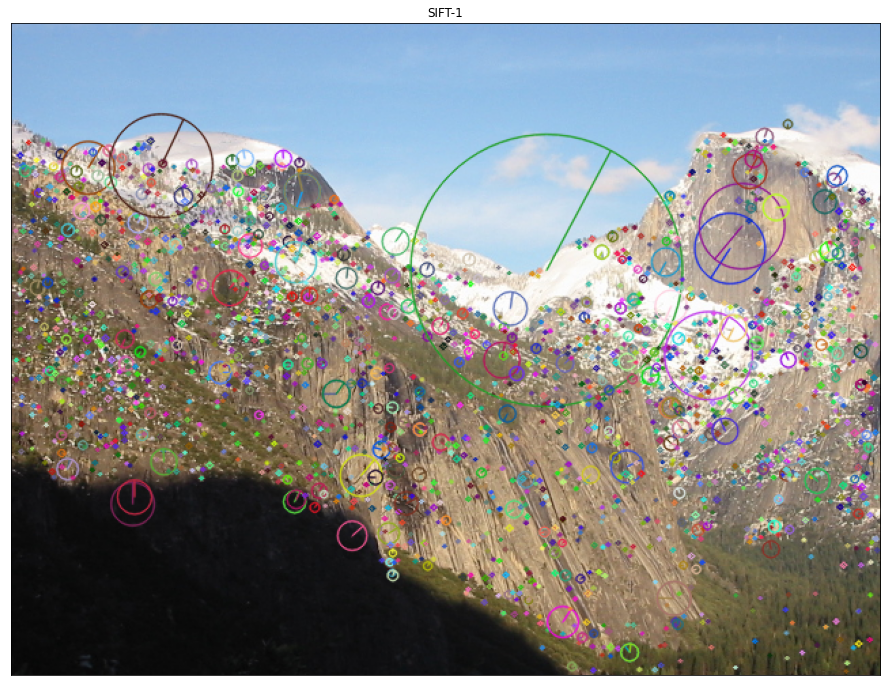

In [ ]:
# Here we check our functions 
img1=P0.readIm(get_image('yosemite1.jpg'),1)
im1=cv2.cvtColor(img1,cv2.COLOR_RGB2GRAY)
img2=P0.readIm(get_image('yosemite2.jpg'),1)
im2=cv2.cvtColor(img2,cv2.COLOR_RGB2GRAY)
# let's compute points and descriptors
im1_kps, im1_dsc = siftPoints(im1)
im2_kps, im2_dsc= siftPoints(im2)
showKP(img1,im1_kps,"SIFT-1")

[WARNING]: Image is in Color
[WARNING]: Normalizing globally


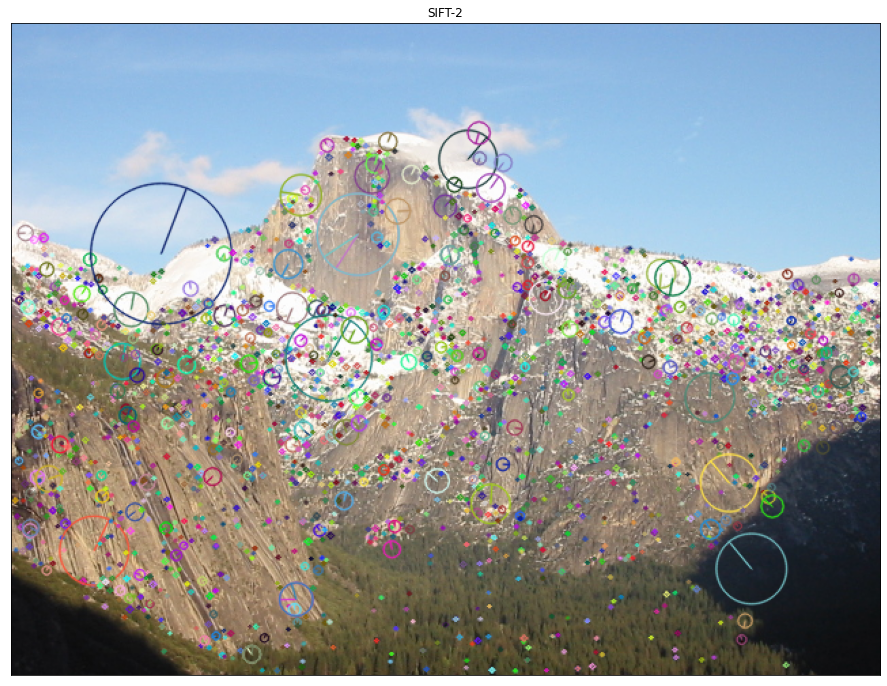

In [ ]:
showKP(img2,im2_kps,"SIFT-2")

Vemos que hemos podido calcular correctamente los puntos de las imágenes ya que también cumplen con las propiedades necesarios como la invarianza a la rotación: (Habría que ignorar la paleta de colores ya que hago uso de la función `random` al generar los colores). 

[WARNING]: Image is in Color
[WARNING]: Normalizing globally


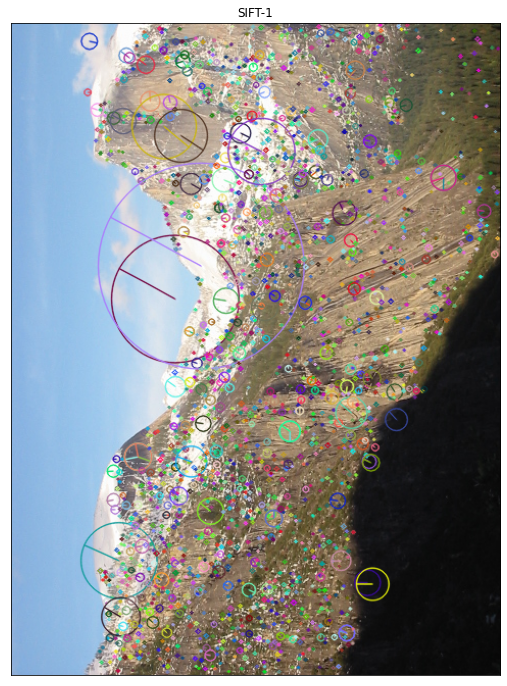

In [ ]:
img1=P0.readIm(get_image('yosemite1.jpg'),1)
img1 = cv2.rotate(img1,cv2.ROTATE_90_COUNTERCLOCKWISE) 
im1=cv2.cvtColor(img1,cv2.COLOR_RGB2GRAY)
img2=P0.readIm(get_image('yosemite2.jpg'),1)
img2 = cv2.rotate(img2,cv2.ROTATE_90_COUNTERCLOCKWISE) 
im2=cv2.cvtColor(img2,cv2.COLOR_RGB2GRAY)
# let's compute points and descriptors
im1_kps, im1_dsc = siftPoints(im1)
im2_kps, im2_dsc= siftPoints(im2)
showKP(img1,im1_kps,"SIFT-1")

[WARNING]: Image is in Color
[WARNING]: Normalizing globally


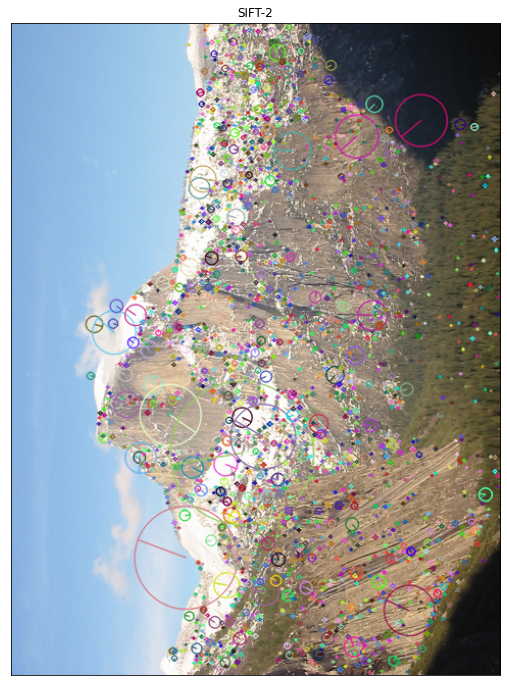

In [ ]:
showKP(img2,im2_kps,"SIFT-2")

Los emparejamientos se generaría fácilmente con una llamada a la función anterior desarrollando las siguientes imágenes: 

[WARNING]: Image is in Color
[WARNING]: Normalizing globally


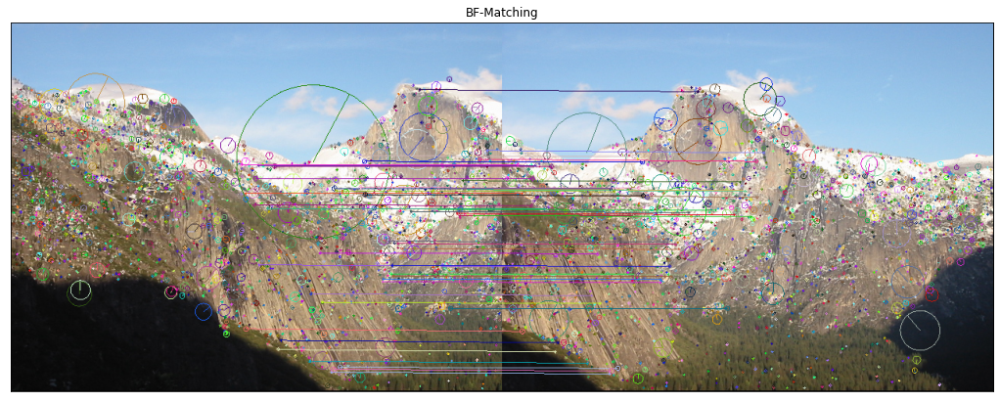

[WARNING]: Image is in Color
[WARNING]: Normalizing globally


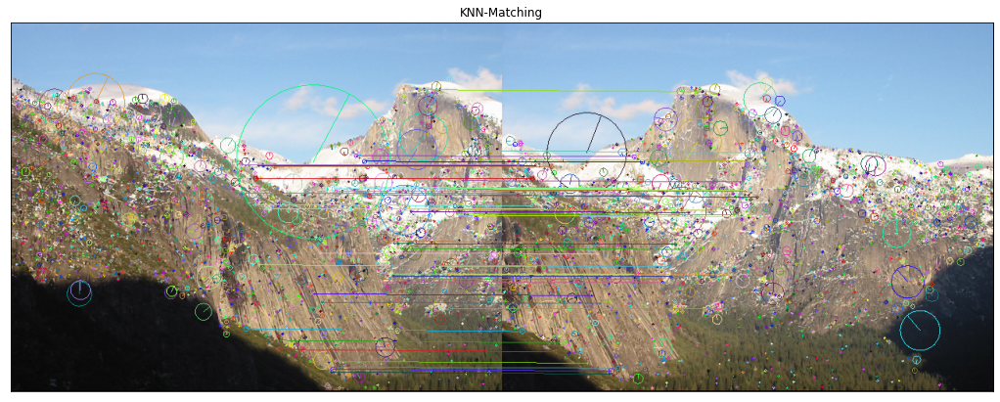

In [ ]:
# Here we check our functions 
img1=P0.readIm(get_image('yosemite1.jpg'),1)
im1=cv2.cvtColor(img1,cv2.COLOR_RGB2GRAY)
img2=P0.readIm(get_image('yosemite2.jpg'),1)
im2=cv2.cvtColor(img2,cv2.COLOR_RGB2GRAY)

im1_kps, im1_dsc = siftPoints(im1)
im2_kps, im2_dsc= siftPoints(im2)
bf_match=matching(im1_dsc,im2_dsc,'BF')
knn_match=matching(im1_dsc,im2_dsc,'KNN')
showMatches(img1,im1_kps, img2,im2_kps,bf_match,50, title='BF-Matching')
showMatches(img1,im1_kps, img2,im2_kps,knn_match,50, title='KNN-Matching')

Y vemos que ambos métodos parecen producir emparejamientos correctos. Y podríamos incluso hacer una homografía para juntar las imágenes y crear un panorama. 

In [ ]:
print(len(bf_match),len(knn_match))

1238 926


La diferencia entre los métodos de emparejamiento queda evidente al ver la diferencia entre la cantidad de puntos aceptados de un método sobre el otro. El método de fuerza bruta acepta muchos más puntos que el otro que además de emparejar puede descartar si no es suficientemente no-ambiguo. 

# **Exercise 3.A:** Homographies calculation (1 point)

Now you are ready to calculate the homographies. To calculate the homography between two images call the function cv2.findHomography(), which takes as input the lists of located KeyPoints (in both images) and the matches found between them. Use RANSAC to perform a robust estimation.

## Introducción teórica 

En geometría, se denomina homografía a toda transformación proyectiva que determina una correspondencia entre dos figuras geométricas planas, de forma que a cada uno de los puntos y las rectas de una de ellas le corresponden, respectivamente, un punto y una recta de la otra.

Existen distintas transformaciones homográficas como son:
  - La Traslación.
  - La simetría.
  - La homología y sus caso particular de la afinidad.

Para obtener la mejor homografía haremos uso del algoritmo RANSAC. Que lo que hace es un método prueba-error (trial-and-error). La idea mejor clave es encontrar la mejora partición de puntos en el conjunto inliers y outliers, estimar el modelo a partir de inliers. 

Es una aproximación a la resolución con mínimos cuadrados para un conjunto del que sabemos que hay "outliers". Una de las cosas a tener en cuenta sobre el algoritmo RANSAC es que es dependiente del modelo o complejidad del problema a resolver, la cantidad estimada de outliers (Funciona cuando se estima un número de outliers inferior al 50%) y el método de cálculo del error de los outliers.

Como hemos vistos en las diapositivas de prácticas podemos estimar el número medio de iteraciones o submostreos a realizar mediante: 
$$ 
T = \frac{log(1-p)}{log(1-(1-e)^s)} 
$$ 

Dónde p es la probabilidad de extraer s puntos y que ninguno de ellos sea un outliers. (En el caso de la homografía S = 4, el número mínimo de puntos), `e` es el ratio estimado de outliers. Hay que tener cuidado ya que el tiempo de cálculo computacional crece rápidamente con la fracción de outliers (e) y el número de parámetros necesarios para ajustar el modelo (s). 


## Implementación 

In [ ]:
# this function computes a homography
def homography(kp1,kp2,matches, Ransac_Error,MIN_MATCH_COUNT=20):
  # the order is important
  if len(matches)>MIN_MATCH_COUNT:
    # Let's extract  two lists of points in correspondences from matches
    src_pts = np.float32([kp1[m.queryIdx].pt for m in matches ]).reshape(-1,1,2)
    dst_pts = np.float32([kp2[m.trainIdx].pt for m in matches ]).reshape(-1,1,2)
    # before changing parameter values, try first the opencv by default.
    p = 0.995 # Confianza del modelo 
    e = 0.1 # Número de outliers estimados 
    s = 4 # Homografías generales necesitan 4 puntos
    T = int((np.log(1-p))/(np.log(1-(1-e)**s)))
    H, mask = cv2.findHomography(src_pts,dst_pts,cv2.RANSAC,
                                 Ransac_Error, None, maxIters=T,confidence=p)
    print('Inliers:', sum(mask))
  else:
     print('Error - very few matches')
  return H

In [ ]:
H = homography(im1_kps,im2_kps,knn_match,1)

Inliers: [237]


Podemos a continuación probar si nuesto algoritmo funciona aplicando la homografía anterior y proyectando los puntos de la imagen 2 sobre la imagen 1 en un canvas negro. 

Para el cálculo de la homografía del canvas podemos utilizar la siguiente matriz: 
$$ 
H_0 = \left[ \matrix{ 1 & 0 & tx \\ 0 & 1 & ty \\ 0 & 0 & 1 } \right] 
$$ 
Dónde $tx$ y $ty$ define el centro del canvas con respecto a la imagen central. 

In [ ]:
im_warp = np.zeros(shape=(img1.shape[0],img1.shape[1]+img2.shape[1],3),dtype=np.uint8)
tx = im_warp.shape[1]//2 - img1.shape[1]//2
ty = im_warp.shape[0]//2 - img1.shape[0]//2
id = np.array([[1,0,tx],[0,1,ty],[0,0,1]],dtype=np.float32)
im_warp = cv2.warpPerspective(img2,id,(im_warp.shape[1],im_warp.shape[0]),dst = im_warp,borderMode = cv2.BORDER_TRANSPARENT) 
comp = id@H
im_warp = cv2.warpPerspective(img1,comp,(im_warp.shape[1],im_warp.shape[0]),dst = im_warp,borderMode = cv2.BORDER_TRANSPARENT) 

[WARNING]: Image is in Color
[WARNING]: Normalizing globally


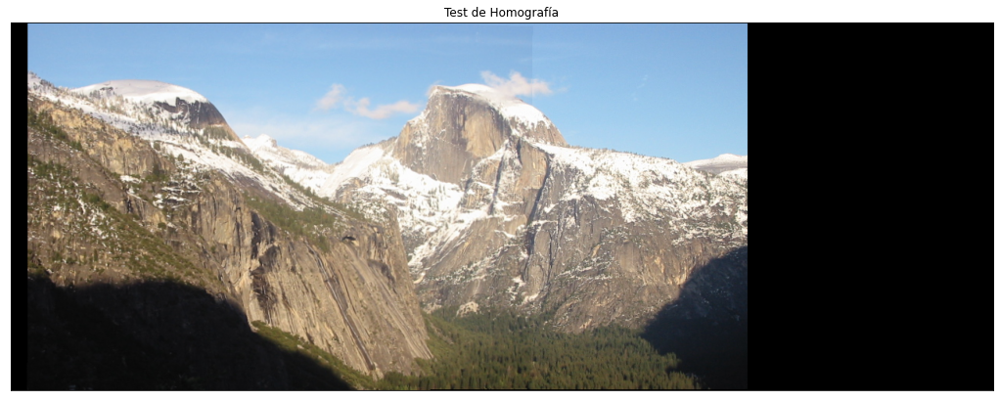

In [ ]:
P0.displayIm(im_warp,title='Test de Homografía',factor=3)

# **Exercise 3.B:** Building a mosaic (4 points)


To compose a mosaic we will need to set several pieces of information. \
a) The size of the canvas according to the number of images to be stitched and their dimensions.\
b) The central image that will give the axes to the mosaic.\
c) The order of each image with respect to the central one.\
d) The homography to copy the central image into the canvas.

Here is the guideline to compute a lineal Mosaic:\
a) Read the images in the order left-right of the camera.\
b) Set one central image as the reference to give axes to the canvas.\
c) Compute the homography between each two consecutive images in your list.\
d) Set the canvas and the reference homography.\
e) Compute the homography between each image and the canvas.\
f) Use  the function cv2.warpPerspective() to transport the images to the canvas using the computed homographies.\
g) Remove redundant black-pixels.



Para el cálculo de las homografías locales, tenemos que pasar las imágenes a la escala de grises como en el algoritmo de Harris y continuación extraer los puntos y descriptores de forma que podamos pasarle esos datos a nuestro método definido anteriormente que nos devuelva las homografías del siguiente orden: 
$$ 
H_0 → H_1 → H_2 →.....
$$ 
Dónde $H_0 = (Img_0 $→$ Img_1)$, es decir, la homografía de la imagen 0 a la imagen 1. Homografías de izquierda a derecha. Saber eso es esencial para los siguientes ejercicios.  

Ya que para componer las homografías, lo necesario para trasladar las imagenes al canvas sobre la imagen a la que corresponde, tenemos que tener en cuenta ese orden. Además, debemos establecer la imagen central, no como aquella que "visualmente encaje", como aquella que es literalmente el punto intermedio. Ya que la composición de homografías implica acumulación de errores. 

La idea es invertir las últimas homografías hasta el punto central. Y luego componer tanto el lado izquierda como el derecho, desde el centro a los extremos, el valor a i+1 con i. 
Ejemplo para $H_c = H_2$ basandonos en el orden anterior:
$$
H_0 \implies H_0 → H_1 \rightarrow H_c 
$$ 
Y luego tendremos una homografía más desde $H_c$ para centrar esa imagen en el canvas. (Como la fórmula que hemos visto anteriormente).  

In [ ]:
# this function computes the homographies between each two consecutive images
def computeLocalHomographies(images,Ransac_Error):
  H=[]
  for item in range(0,len(images)-1):
    im1=cv2.cvtColor(images[item],cv2.COLOR_RGB2GRAY)
    im2=cv2.cvtColor(images[item+1],cv2.COLOR_RGB2GRAY)
    kp1,ds1=siftPoints(im1) 
    kp2,ds2=siftPoints(im2) 
    matches=matching(ds1,ds2,'KNN')
    Haux=homography(kp1,kp2,matches,Ransac_Error,MIN_MATCH_COUNT=20)
    H.append(Haux)
    #print(Haux)
  return H

# this function computes the homography from each image to the canvas
def mosaicHomographies(H,idx):
  # idx is the index of the reference image
  # invert homographies
  for item in range(idx,len(H)):
    H[item] = np.linalg.inv(H[item]) 
  # compute homographies by compositoon
  for item in range(idx-2,-1,-1):
    H[item] = H[item+1]@H[item]
  for item in range(idx+1,len(H),1):
    H[item] = H[item-1]@H[item]
  return H

# this function fixes the homography from the central image to the canvas
# others definitions are possible
def axesHomography(nim,sizeim,sizecanvas):
  H=np.eye(3)
  H[0,2]=sizecanvas[1]//2-sizeim[1]//2
  H[1,2]=sizecanvas[0]//2-sizeim[0]//2
  return H

Luego para asegurarnos que todas las imágenes caen dentro del canvas tenemos que crear uno que sea suficientemente grande. Para ello suponemos el peor de los casos donde las imagenes encajan perfectamente en sus extremos y por lo tanto 3 imágenes que encajan perfectamente en sus extremos tendrán un ancho 3 veces (o la suma de los anchos de las imágenes si tuvieran diferentes tamaños) el tamaño original. 

Luego disponemos de una función `blackOut` que nos sirvirá para limpiar las zonas no usadas del canvas. Para ello simplemente miraremos la cantidad de valores iguales a 0 y calcularemos la máscara que contorna los valores diferentes.  

Por último, recogemos las imágenes de izquierda a derecha y componemos las homografías que habíamos calculados con la homografía $H_0$. Y con uso de `cv2.warpPerspective` calculamos fácilmente la homografía.

In [ ]:
# Auxiliary functions
# this function defines and return the canvas
def setCanvas(row,col,flagColor,nim=2):
  rows=row*nim
  cols=col*nim
  if flagColor==3:
    return np.zeros(shape=(rows,cols,3),dtype=np.uint8)
  else:
    return np.zeros(shape=(rows,cols),dtype=np.uint8)

# This function removes the redundant black-pixels from the canvas
def blackOut(img):
  if len(img.shape)==3:
    im =cv2.cvtColor(img,cv2.COLOR_RGB2GRAY)
    mask = np.array((im > 0), np.uint8) 
    x,y,w,h=cv2.boundingRect(mask)
    return img[y:y+h,x:x+w,:]
  else:
    mask = np.array((img > 0), np.uint8) 
    x,y,w,h=cv2.boundingRect(mask)
    return img[y:y+h,x:x+w]
  
# this function composes the mosaic from the extremes to the center
# transporting each image with its homography
def composeMosaic(images,canvas,H,idxc,H0,flagAffinity):
  nH=0
  # global composition
  for nim in range(0,idxc):
    if nim == idxc:
      #print('nim=',nim,'nH=',0)
      Haux=H0
    else:
      #print('nim=',nim,'nH=',nH)
      Haux=H0@H[nH]
      nH=nH+1
    #print(Haux/Haux[2,2])
    canvas = cv2.warpPerspective(images[nim],Haux,(canvas.shape[1],canvas.shape[0]),dst=canvas, flags=cv2.INTER_CUBIC, borderMode=cv2.BORDER_TRANSPARENT)
    #P0.displayIm(blackOut(canvas),'Imagen:'+str(nim),2)
  nH=len(H)-1

  for nim in range(len(images)-1,idxc-1,-1):
    if nim == idxc:
      #print('nim=',nim,'nH=',0)
      Haux=H0
    else:
      #print('nim=',nim,'nH=',nH)
      Haux=H0@H[nH]
      nH=nH-1
    #print(Haux/Haux[2,2])
    canvas = cv2.warpPerspective(images[nim],Haux,(canvas.shape[1],canvas.shape[0]), dst=canvas,flags=cv2.INTER_CUBIC, borderMode=cv2.BORDER_TRANSPARENT)
    #P0.displayIm(blackOut(canvas),'Imagen: '+str(nim),2)
  return canvas


The next cell contains the mosaic catalog with 5 possible scenarios: 

- EXAMPLE 1 (rectangular projection with 4 Yosemite images) (2 points)

- EXAMPLE 2 (rectangular projection with 8 corridor images) (3 points)

- EXAMPLE 3 (rectangular projection with 10 office images) (4 points)

- EXAMPLE 4 (14 images of Granada/Alhambra, mainly for spherical projection; see Bonus)

- EXAMPLE 5 (14 images of Sierra Nevada, mainly for spherical projection; see Bonus)

In [ ]:
# CATALOG OF MOSAIC

# Mosaic construction: All of them are Left-Right camera motion

def loadImages(mosaicIndex): 
  images = []
  #EXAMPLE:1 (easy, for rectangular projection) (2 points)
  if mosaicIndex==1: 
    PREFIX = ''
    nameImages=['yosemite1.jpg','yosemite2.jpg','yosemite3.jpg','yosemite4.jpg']
    for item in nameImages:
      images.append(P0.readIm(get_image(PREFIX+item),flagColor=1))
  
  # EXAMPLE-2 (rectangular projection, tricky in a couple of homographies) (3 points)
  elif mosaicIndex==2:
    PREFIX = 'corridor/'
    nameImages=['Picture1.jpg','Picture2.jpg','Picture3.jpg','Picture4.jpg','Picture5.jpg','Picture6.jpg','Picture7.jpg','Picture8.jpg']
    for item in nameImages:
      images.append(P0.readIm(get_image(PREFIX+item),flagColor=1))
  
  # EXAMPLE-3 (rectangular projection) (4 points)
  elif mosaicIndex==3:
    PREFIX = 'despacho/'
    nameImages=['mosaico002.jpg','mosaico003.jpg','mosaico004.jpg','mosaico005.jpg','mosaico006.jpg',
            'mosaico007.jpg','mosaico008.jpg','mosaico009.jpg','mosaico010.jpg','mosaico011.jpg']
    for item in nameImages:
      images.append(P0.readIm(get_image(PREFIX+item),flagColor=1))
  
  # EXAMPLE-4 (mainly for spherical projection)
  elif mosaicIndex==4:
    PREFIX = 'Granada/IMG_20211030_1104'
    nameImages=['10_S.jpg','13_S.jpg','15_S.jpg','17_S.jpg','18_S.jpg','20_S.jpg',
            '21_S.jpg', '25_S.jpg','26_S.jpg', '28_S.jpg','31_S.jpg','33_S.jpg',
            '34_S.jpg','36_S.jpg']
    for item in nameImages:
      images.append(P0.readIm(get_image(PREFIX+item),flagColor=1))
  
  
  # EXAMPLE-5 (mainly for spherical projection)
  elif mosaicIndex==5:
    PREFIX = 'SierraNevada/IMG_20220312_1029'
    nameImages=['31_S.jpg','32_S.jpg','34_S.jpg','37_S.jpg','40_S.jpg','42_S.jpg',
            '44_S.jpg','46_S.jpg','48_S.jpg','50_S.jpg','51_S.jpg','54_S.jpg',
            '57_S.jpg','58_S.jpg'] 
    for item in nameImages:
      images.append(P0.readIm(get_image(PREFIX+item),flagColor=1))
  else:
    print('Error - no such Mosaic')

  return images 

Rectangular projection: The target is example-3. Example 1 and 2 are also possible but you get a lower mark (see the mosaic catalog). You must use all images.

read images 4
idxc 1
Inliers: [150]
Inliers: [31]
Inliers: [190]
[WARNING]: Image is in Color
[WARNING]: Normalizing globally


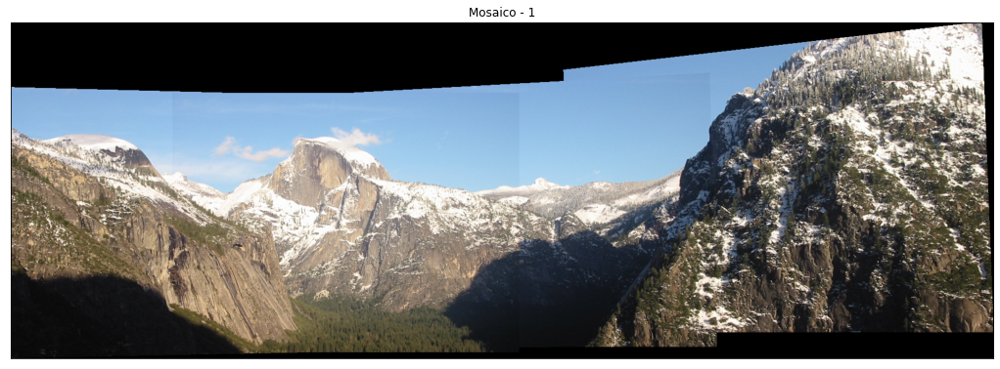

In [ ]:
images = loadImages(1)
print('read images',len(images))
# Set the central image 
idxc=len(images)//2-1
print('idxc',idxc)
# Compute local homographies beetwen images
H=computeLocalHomographies(images,3)
# Set the canvas
canvas=setCanvas(images[idxc].shape[0],images[idxc].shape[1],3,len(images))
# Compute the homography given axis to the canvas
H0=axesHomography(len(images),images[idxc].shape,canvas.shape)
# Compute the homogra
H=mosaicHomographies(H,idxc)
# Compose the mosaic transporting the images into the canvas
mosaic=composeMosaic(images,canvas,H,idxc,H0,False)
P0.displayIm(blackOut(mosaic),'Mosaico - 1', 3) 

Inliers: [29]
Inliers: [99]
Inliers: [151]
Inliers: [114]
Inliers: [124]
Inliers: [119]
Inliers: [46]
[WARNING]: Image is in Color
[WARNING]: Normalizing globally


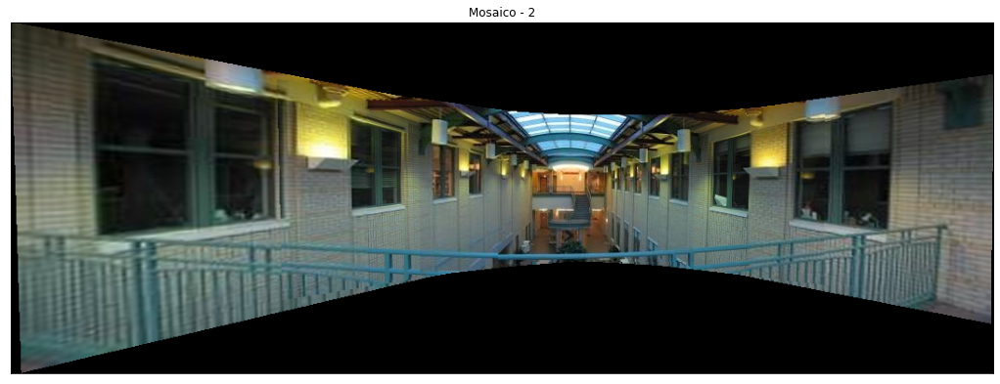

In [ ]:
images = loadImages(2) 
idxc=len(images)//2
H=computeLocalHomographies(images,3)
canvas=setCanvas(images[idxc].shape[0],images[idxc].shape[1],3,len(images)) 
H0=axesHomography(len(images),images[idxc].shape,canvas.shape)
H=mosaicHomographies(H,idxc)
mosaic= composeMosaic(images,canvas,H,idxc,H0,False)
P0.displayIm(blackOut(mosaic),'Mosaico - 2',3)

Con esta imagen de hecho, se verifica fácilmente el efecto trompeta si no elegimos bien el punto central. Ese efecto de la proyección genera distorsiones sobre la imagen original de forma que se alarga, ensancha y/o se inclina. (Entre otras). 

Inliers: [29]
Inliers: [99]
Inliers: [151]
Inliers: [114]
Inliers: [124]
Inliers: [119]
Inliers: [46]
[WARNING]: Image is in Color
[WARNING]: Normalizing globally


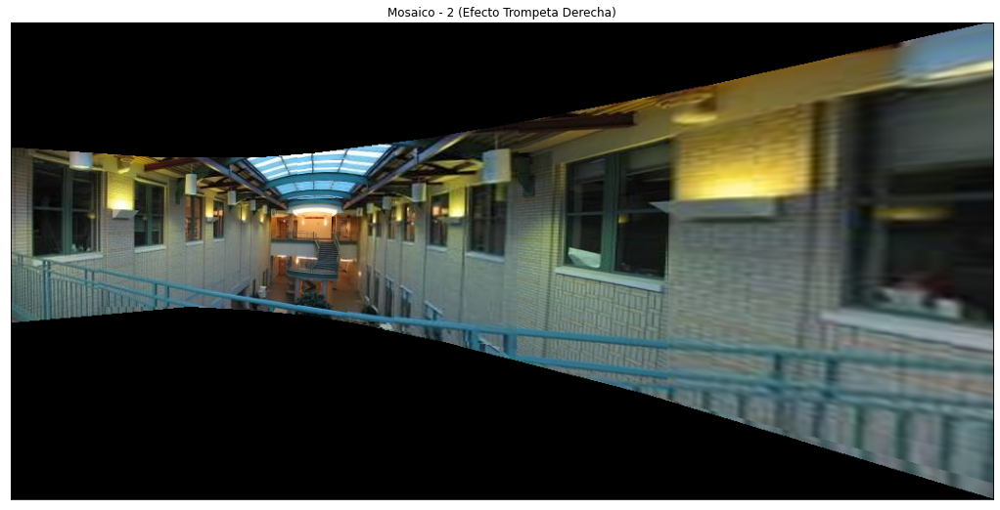

In [ ]:
images = loadImages(2) 
idxc=len(images)//2-3
H=computeLocalHomographies(images,3)
canvas=setCanvas(images[idxc].shape[0],images[idxc].shape[1],3,len(images)) 
H0=axesHomography(len(images),images[idxc].shape,canvas.shape)
H=mosaicHomographies(H,idxc)
mosaic= composeMosaic(images,canvas,H,idxc,H0,False)
P0.displayIm(blackOut(mosaic),'Mosaico - 2 (Efecto Trompeta Derecha)',3)

Inliers: [113]
Inliers: [144]
Inliers: [147]
Inliers: [164]
Inliers: [211]
Inliers: [77]
Inliers: [11]
Inliers: [105]
Inliers: [225]
[WARNING]: Image is in Color
[WARNING]: Normalizing globally


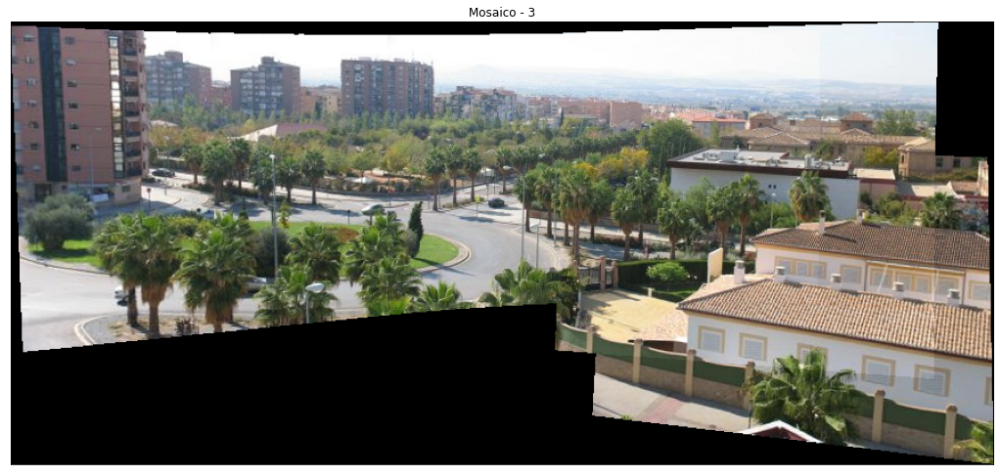

In [ ]:
images = loadImages(3) 
idxc=len(images)//2
H=computeLocalHomographies(images,3)
canvas=setCanvas(images[idxc].shape[0],images[idxc].shape[1],3,len(images)) 
H0=axesHomography(len(images),images[idxc].shape,canvas.shape)
H=mosaicHomographies(H,idxc)
mosaic= composeMosaic(images,canvas,H,idxc,H0,False)
P0.displayIm(blackOut(mosaic),'Mosaico - 3',3)

# **BONUS**: Spherical projection.  (3 points)
Use Examples 4 or 5's images and show the case f=500. You must use all images.

[Artículo original](https://dl.acm.org/doi/pdf/10.1145/258734.258861)

Para el cálculo de las proyecciones esféricas tenemos que seguir un par de pasos: 
1. Determinamos el centro de la imagen de entrada a componer en el mosaic ($x_c$ e $y_c$) y escogemos una f, ó s, que en este caso es 500. 
2. Calculamos $\theta$ y $\phi$, los ángulos que determinan cualquier punto en la esfera según el tamaño de las imágenes. 
  - $\theta = \frac{\frac{height}{2}}{f}$ 
  - $\phi = \frac{\frac{width}{2}}{f}$
3. Creamos un rango de valores que van de $-\theta$ y $\theta$ y de $-\phi$ y $\phi$, con tantos elementos como píxeles de alto y ancho de la imagen, respectivamente.
4. Ahoramos podemos pasar las coordenadas a los píxeles de la imagen a las coordenadas esféricas mediante una proyección como sigue: 
$$ 
\hat x = sin\theta cos\phi \\
\hat y = sin\phi \\ 
\hat z = cos\theta cos\phi 
$$ 
5. Y luego obtenemos los valores de la imagen de vuelta mediante: 
$$ 
x  = f\hat x / \hat z + x_c \\ 
y  = f\hat y / \hat z + y_c 
$$ 

Algunos beneficios que nos provee las proyecciones cilíndricas están: 
- Mapear imágenes a superficies planes se adaptar mejor a la visión natural de las escenas.
- Las distorsiones que ocurren en los extremos de las imágenes desaparecen. 
- Las imágenes que se solapan se registran como una simple traslación en la superficie. 


In [ ]:
def spherical_lookupTable (f,imsize):
  # Here we compute the spherical coordinates where the image pixel project.
  # A sphere of radius r=f is fixed.
  # Begin by discretizing the azimuth and elevation ranges according to the image size and the focal length fixed. 
  # Then compute the coordinates on the sphere for each couple of angle-values ( azimuth and elevation)
  # return the computed coordinates
  # Slides and Szeliski's book equations will help
  theta = np.arctan2(imsize[1],(2*f))
  phi = np.arctan2(imsize[0],(2*f))
  tt = np.linspace(-theta,theta,imsize[1]) 
  pp = np.linspace(-phi, phi,imsize[0]) 
  mpp, mtt = np.meshgrid(pp,tt) 
   # compute actual points on the sphere
  _x = np.sin(mtt) * np.cos(mpp)
  _y = np.sin(mpp)
  _z = np.cos(mtt) * np.cos(mpp) 
  x = f * _x/_z + imsize[1]//2
  y = f * _y/_z + imsize[0]//2


  return x.astype(np.float32),y.astype(np.float32)

def sphericalTrim(images,cutPix):
  # here we eliminate by left and right, above and below each image the number the
  # lines indicates in cutPix=[#row,#column]
  h = images.shape[0]
  w = images.shape[1] 
  images = images[cutPix[0]:h-cutPix[0],cutPix[1]:w-cutPix[1]]
  return images

def sphericalProjection(images,f,cutpix):
  # Here we interpolate a rectangular mesh of values from the  projection of the pixels.
  # images: set of images; f: focal length; cutpix: #row and #column to remove
  shpim=[]
  temp = []
  for img in images: 
    x, y = spherical_lookupTable(f,img.shape)
    temp = cv2.remap(img,x,y,cv2.INTER_AREA)
    temp = np.swapaxes(temp,0,1)
    shpim.append(np.array(temp.copy(),dtype=np.uint8))
  # after projection images must be trimmed
  if len(cutpix)>0:
    for i in range(0,len(shpim)):
      shpim[i] = sphericalTrim(shpim[i],cutpix)
  return shpim  # vector of projected images
    


Podemos ver a continuación que hemos obtenido un resultado y comportamiento correcto. Ya que si variamos la distancia focal podemos ver como afecta directamente a la imagen final interpolada: 

(300, 400, 3)
[WARNING]: Image is in Color
[WARNING]: Normalizing globally


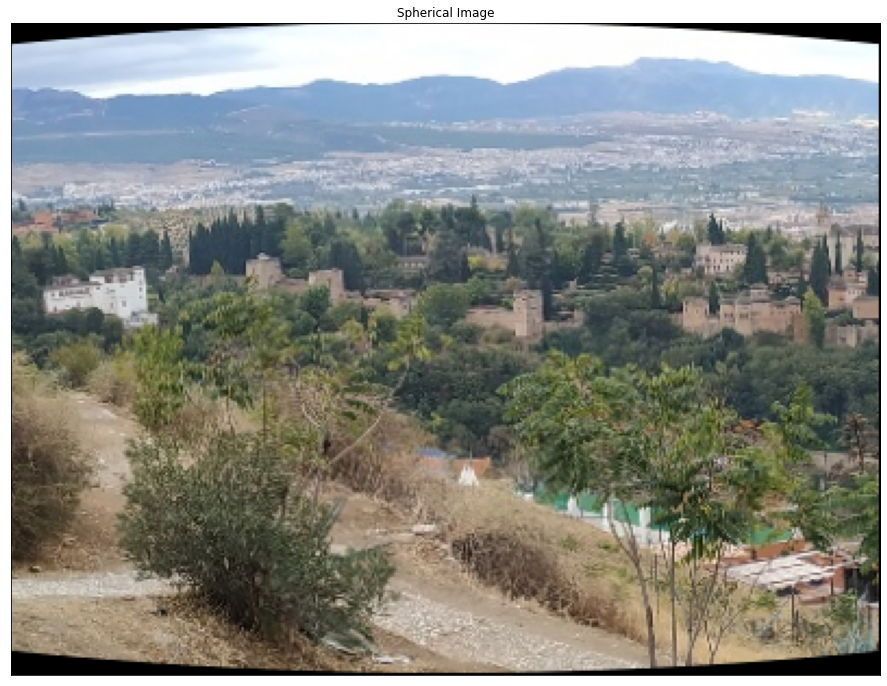

In [ ]:
from numpy.linalg import inv
 # HERE CONSIDER A SPHERICAL PROJECTION
images = loadImages(4) 
print(images[0].shape) 
flagSpherical=True
if flagSpherical:
  images=sphericalProjection(images,500,[])

P0.displayIm(images[0],'Spherical Image',3) 

Con una distancia focal menor deberíamos ver una imagen más "esférica":

(300, 400, 3)
[WARNING]: Image is in Color
[WARNING]: Normalizing globally


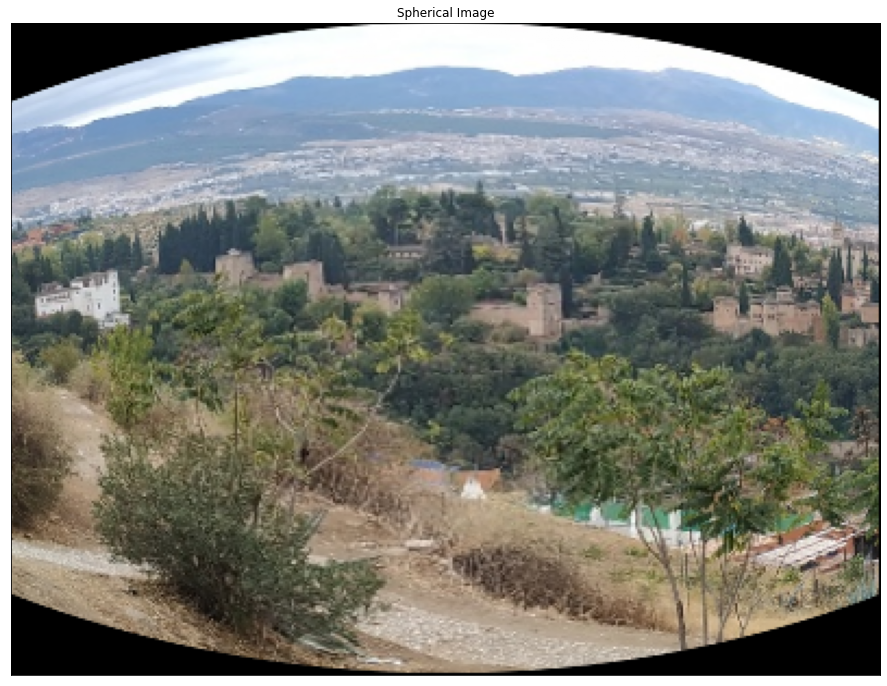

In [ ]:
 # HERE CONSIDER A SPHERICAL PROJECTION
images = loadImages(4) 
print(images[0].shape) 
flagSpherical=True
if flagSpherical:
  images=sphericalProjection(images,200,[])

P0.displayIm(images[0],'Spherical Image',3) 

Mientras que con una distancia focal más grandes deberíamos ver una imagen más "cuadrada", sin distorsiones: 

(300, 400, 3)
[WARNING]: Image is in Color
[WARNING]: Normalizing globally


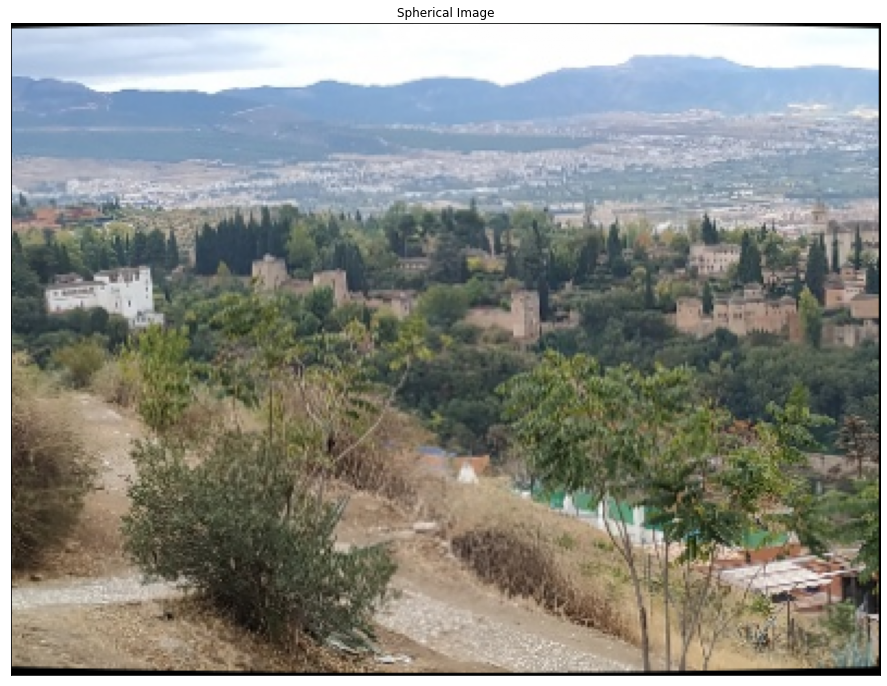

In [ ]:
 # HERE CONSIDER A SPHERICAL PROJECTION
images = loadImages(4) 
print(images[0].shape) 
flagSpherical=True
if flagSpherical:
  images=sphericalProjection(images,1000,[])

P0.displayIm(images[0],'Spherical Image',3) 

Pero la distancia focal viene dada por el dispositivo con el que se mostreo las imágenes, en nuestro caso $f=500$. Para quitar las distorsiones tenemos que algunas filas/columnas de la imagen. Si quitamos 15 filas y 10 columnas vemos que obtenemos una versión similar a la imagen original:

(300, 400, 3)
[WARNING]: Image is in Color
[WARNING]: Normalizing globally


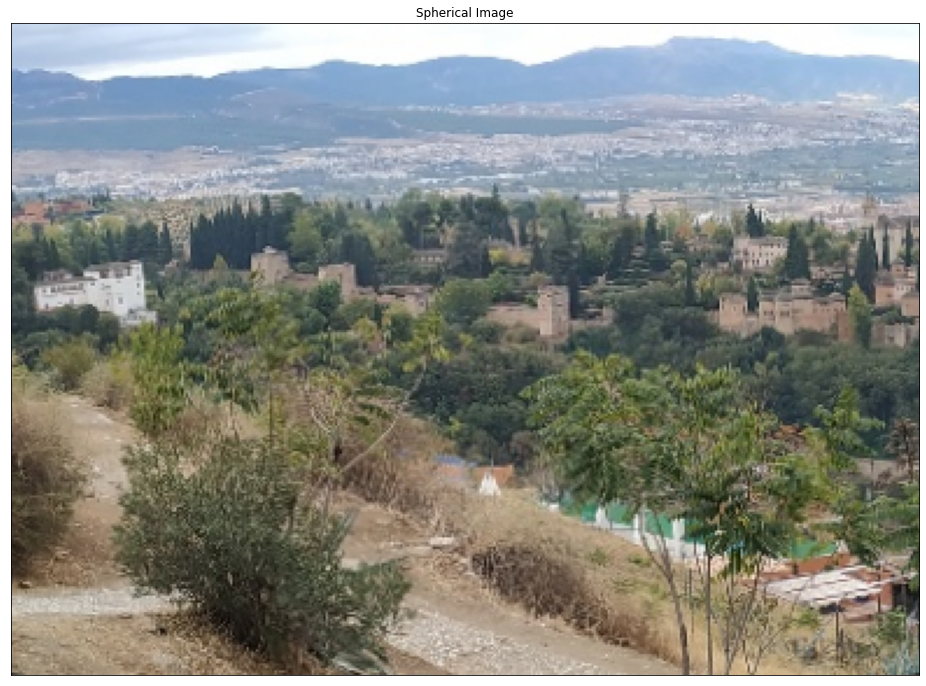

In [ ]:
from numpy.linalg import inv
 # HERE CONSIDER A SPHERICAL PROJECTION
images = loadImages(4) 
print(images[0].shape) 
flagSpherical=True
if flagSpherical:
  images=sphericalProjection(images,500,[10,5])

P0.displayIm(images[0],'Spherical Image',3) 

Si aplicamos las mismas homografías, tendríamos el panorama generado con proyecciones esféricas: 

read images 14
idxc 7
Inliers: [179]
Inliers: [4]
Inliers: [3]
Inliers: [243]
Inliers: [48]
Inliers: [75]
Inliers: [223]
Inliers: [217]
Inliers: [204]
Inliers: [188]
Inliers: [64]
Inliers: [215]
Inliers: [102]
[WARNING]: Image is in Color
[WARNING]: Normalizing globally


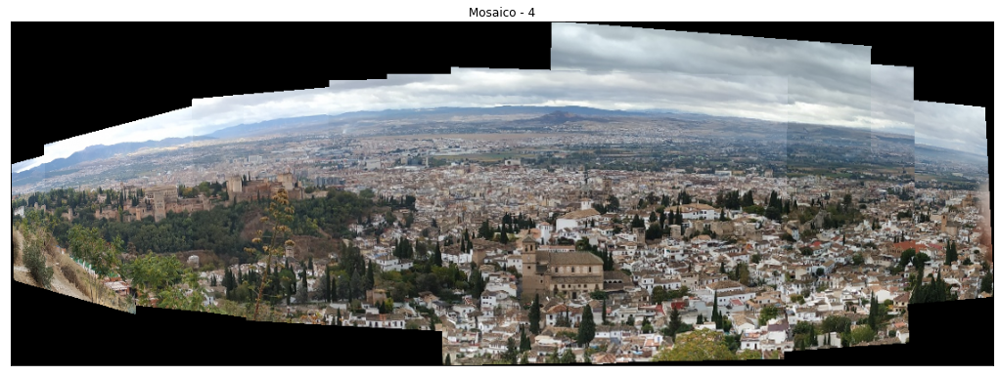

In [ ]:
print('read images',len(images))
# Set the central image 
idxc=len(images)//2
print('idxc',idxc)
# Compute local homographies beetwen images
H=computeLocalHomographies(images,3)
# Set the canvas
canvas=setCanvas(images[idxc].shape[0],images[idxc].shape[1],3,len(images))
# Compute the homography given axis to the canvas
H0=axesHomography(len(images),images[idxc].shape,canvas.shape)
# Compute the homogra
H=mosaicHomographies(H,idxc)
# Compose the mosaic transporting the images into the canvas
mosaic=composeMosaic(images,canvas,H,idxc,H0,flagSpherical)
P0.displayIm(blackOut(mosaic),'Mosaico - 4', 3) 

In [ ]:
 # HERE CONSIDER A SPHERICAL PROJECTION
images = loadImages(5) 
print(images[0].shape) 
flagSpherical=True
if flagSpherical:
  images=sphericalProjection(images,500,[int(images[0].shape[0]*0.15),int(images[0].shape[1]*0.15)])
print('read images',len(images))
# Set the central image 
idxc=len(images)//2
print('idxc',idxc)
# Compute local homographies beetwen images
H=computeLocalHomographies(images,3)
# Set the canvas
canvas=setCanvas(images[idxc].shape[0],images[idxc].shape[1],3,len(images)) 

(1200, 1600, 3)
read images 14
idxc 7
Inliers: [114]
Inliers: [236]
Inliers: [74]
Inliers: [24]
Inliers: [254]
Inliers: [178]
Inliers: [172]
Inliers: [157]
Inliers: [150]
Inliers: [143]
Inliers: [164]
Inliers: [172]
Inliers: [193]


[WARNING]: Image is in Color
[WARNING]: Normalizing globally


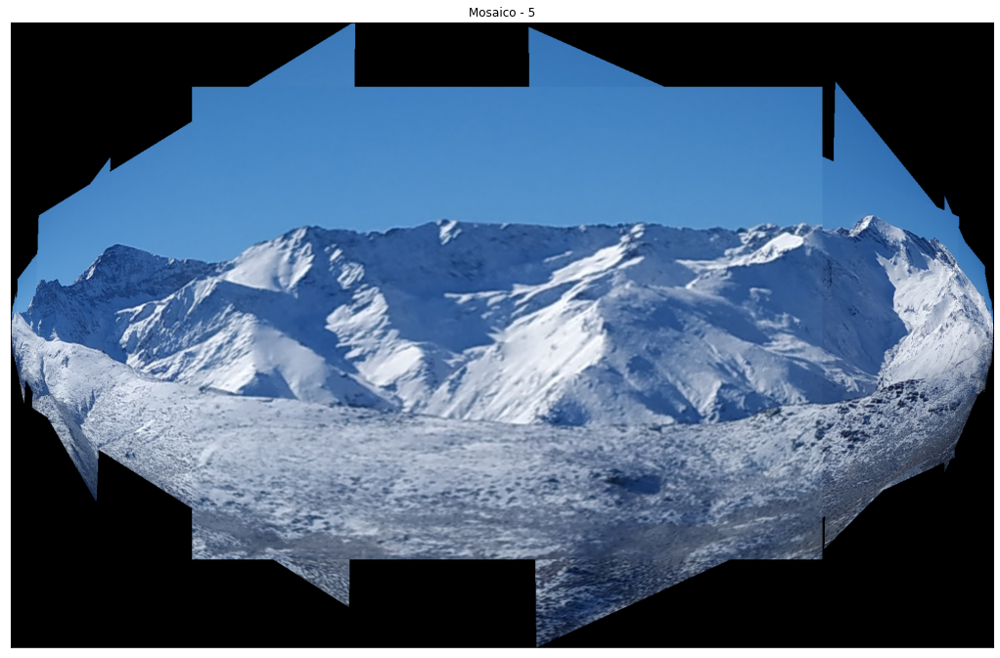

In [ ]:
H0=axesHomography(len(images),images[idxc].shape,canvas.shape)
# Compute the homogra
H=mosaicHomographies(H,idxc)
# Compose the mosaic transporting the images into the canvas
mosaic=composeMosaic(images,canvas,H,idxc,H0,flagSpherical)
P0.displayIm(blackOut(mosaic),'Mosaico - 5', 3) 